# Исследование продаж

## План:
1. Загрузка и подготовка данных
2. Проверка качества данных (пропуски, аномалии)
3. Анализ покупателей
4. Анализ групп товаров
5. Экспорт в standalone HTML

## 1. Загрузка и подготовка данных

In [73]:
import pandas as pd
import numpy as np
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import warnings
warnings.filterwarnings('ignore')

In [74]:
# Загрузка Excel файла
file_path = 'test_sales_data.xlsx'
df_raw = pd.read_excel(file_path, header=None)
print(f'Размер данных: {df_raw.shape}')
df_raw.head(10)

Размер данных: (1004, 3025)


,0,1,2,3,4,5,6,7,8,9,...,3015,3016,3017,3018,3019,3020,3021,3022,3023,3024
0,NaN,2023,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,Январь,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,Группа 1,NaN,NaN,Группа 2,NaN,NaN,Группа 3,NaN,NaN,...,NaN,Группа 26,NaN,NaN,Группа 27,NaN,NaN,Группа 28,NaN,NaN
3,ИД клиента,Количество в чеке,Сумма в чеке,Число чеков,Количество в чеке,Сумма в чеке,Число чеков,Количество в чеке,Сумма в чеке,Число чеков,...,Число чеков,Количество в чеке,Сумма в чеке,Число чеков,Количество в чеке,Сумма в чеке,Число чеков,Количество в чеке,Сумма в чеке,Число чеков
4,CLIENT_0001,29,28966.08,8,39,89098.64,7,NaN,NaN,NaN,...,NaN,29,35332.25,2,13,48912.21,7,4,19172.68,1
5,CLIENT_0002,NaN,NaN,NaN,20,55359.27,6,26,27549.13,9,...,6,32,37317.79,6,3,1313.24,1,7,9411.68,2
6,CLIENT_0003,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,37,72095.79,5,17,12281.9,9,10,40730.58,7
7,CLIENT_0004,37,166529.85,1,26,74304.57,5,34,19663.29,3,...,7,NaN,NaN,NaN,15,54184.63,2,NaN,NaN,NaN
8,CLIENT_0005,20,23045.86,3,33,96613.42,3,NaN,NaN,NaN,...,1,NaN,NaN,NaN,39,96192.39,4,7,27778.31,6
9,CLIENT_0006,24,8084.66,8,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,5,13147.71,2,4,1199.16,4,10,1861.91,6


In [75]:
# Парсинг шапки - заполняем объединённые ячейки
years_row = df_raw.iloc[0, 1:].ffill().values
months_row = df_raw.iloc[1, 1:].ffill().values
groups_row = df_raw.iloc[2, 1:].ffill().values
metrics_row = df_raw.iloc[3, 1:].values

print('Годы:', pd.Series(years_row).unique())
print('Месяцы:', pd.Series(months_row).unique())
print('Группы:', pd.Series(groups_row).unique()[:5], '...')
print('Показатели:', pd.Series(metrics_row).unique())

Годы: [2023 2024 2025]
Месяцы: ['Январь' 'Февраль' 'Март' 'Апрель' 'Май' 'Июнь' 'Июль' 'Август'
 'Сентябрь' 'Октябрь' 'Ноябрь' 'Декабрь']
Группы: ['Группа 1' 'Группа 2' 'Группа 3' 'Группа 4' 'Группа 5'] ...
Показатели: ['Количество в чеке' 'Сумма в чеке' 'Число чеков']


In [76]:
# Создание MultiIndex для столбцов
columns = pd.MultiIndex.from_arrays(
    [years_row, months_row, groups_row, metrics_row],
    names=['Год', 'Месяц', 'Группа', 'Показатель']
)

# Данные клиентов
df = df_raw.iloc[4:].copy()
df.columns = ['client_id'] + list(range(len(df.columns) - 1))
df = df.set_index('client_id')
df.columns = columns

print(f'Количество клиентов: {len(df)}')
df.head()

Количество клиентов: 1000


Год                      2023                                             \
Месяц                  Январь                                              
Группа               Группа 1                                   Группа 2   
Показатель  Количество в чеке Сумма в чеке Число чеков Количество в чеке   
client_id                                                                  
CLIENT_0001                29     28966.08           8                39   
CLIENT_0002               NaN          NaN         NaN                20   
CLIENT_0003               NaN          NaN         NaN               NaN   
CLIENT_0004                37    166529.85           1                26   
CLIENT_0005                20     23045.86           3                33   

Год                                                                  \
Месяц                                                                 
Группа                                        Группа 3                
Показатель  Сумма в чеке Число чеков Количество в чеке Сумма в чеке   
client_id                                                             
CLIENT_0001     89098.64           7               NaN          NaN   
CLIENT_0002     55359.27           6                26     27549.13   
CLIENT_0003          NaN         NaN               NaN          NaN   
CLIENT_0004     74304.57           5                34     19663.29   
CLIENT_0005     96613.42           3               NaN          NaN   

Год                                        ...        2025                    \
Месяц                                      ...     Декабрь                     
Группа                           Группа 4  ...   Группа 25         Группа 26   
Показатель  Число чеков Количество в чеке  ... Число чеков Количество в чеке   
client_id                                  ...                                 
CLIENT_0001         NaN                36  ...         NaN                29   
CLIENT_0002           9                10  ...           6                32   
CLIENT_0003         NaN               NaN  ...         NaN                37   
CLIENT_0004           3                26  ...           7               NaN   
CLIENT_0005         NaN               NaN  ...           1               NaN   

Год                                                                  \
Месяц                                                                 
Группа                                       Группа 27                
Показатель  Сумма в чеке Число чеков Количество в чеке Сумма в чеке   
client_id                                                             
CLIENT_0001     35332.25           2                13     48912.21   
CLIENT_0002     37317.79           6                 3      1313.24   
CLIENT_0003     72095.79           5                17      12281.9   
CLIENT_0004          NaN         NaN                15     54184.63   
CLIENT_0005          NaN         NaN                39     96192.39   

Год                                                                 
Месяц                                                               
Группа                          Группа 28                           
Показатель  Число чеков Количество в чеке Сумма в чеке Число чеков  
client_id                                                           
CLIENT_0001           7                 4     19172.68           1  
CLIENT_0002           1                 7      9411.68           2  
CLIENT_0003           9                10     40730.58           7  
CLIENT_0004           2               NaN          NaN         NaN  
CLIENT_0005           4                 7     27778.31           6  

[5 rows x 3024 columns]

In [77]:
# Преобразование в long format
df_long = df.stack(level=['Год', 'Месяц', 'Группа']).reset_index()
df_long.columns.name = None
print(f'Размер long format: {df_long.shape}')
df_long.head(10)

Размер long format: (704911, 7)


,client_id,Год,Месяц,Группа,Количество в чеке,Сумма в чеке,Число чеков
0,CLIENT_0001,2023,Август,Группа 1,1,2453.81,1
1,CLIENT_0001,2023,Август,Группа 10,13,14500.4,1
2,CLIENT_0001,2023,Август,Группа 11,32,10553.37,8
3,CLIENT_0001,2023,Август,Группа 13,3,7946.4,1
4,CLIENT_0001,2023,Август,Группа 14,5,2666,3
5,CLIENT_0001,2023,Август,Группа 15,48,117706.81,7
6,CLIENT_0001,2023,Август,Группа 16,21,67890.28,3
7,CLIENT_0001,2023,Август,Группа 17,34,61807.89,2
8,CLIENT_0001,2023,Август,Группа 18,15,33654.41,2
9,CLIENT_0001,2023,Август,Группа 19,38,87759.53,7


## 2. Проверка качества данных

In [78]:
# Проверка пропусков
missing_stats = df_long.isnull().sum()
missing_pct = (df_long.isnull().sum() / len(df_long) * 100).round(2)

print('Пропуски по столбцам:')
for col in df_long.columns:
    print(f'  {col}: {missing_stats[col]} ({missing_pct[col]}%)')

Пропуски по столбцам:
  client_id: 0 (0.0%)
  Год: 0 (0.0%)
  Месяц: 0 (0.0%)
  Группа: 0 (0.0%)
  Количество в чеке: 0 (0.0%)
  Сумма в чеке: 0 (0.0%)
  Число чеков: 0 (0.0%)


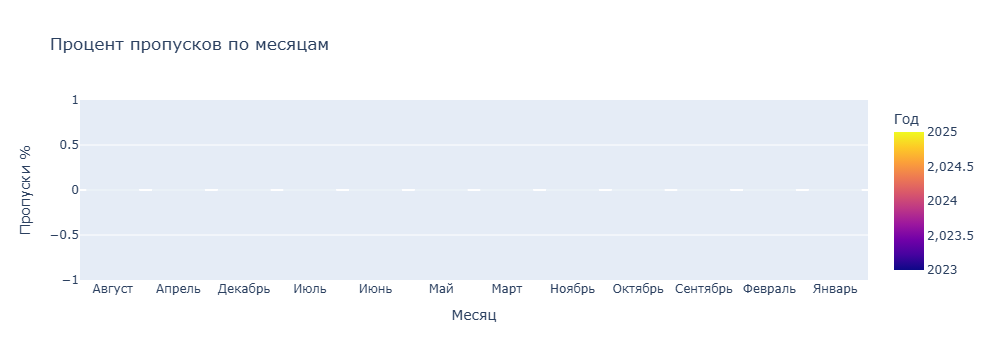

In [79]:
# Визуализация пропусков по месяцам
missing_by_month = df_long.groupby(['Год', 'Месяц']).apply(
    lambda x: x['Сумма в чеке'].isnull().sum() / len(x) * 100
).reset_index(name='Пропуски %')

fig = px.bar(missing_by_month, x='Месяц', y='Пропуски %', color='Год',
             title='Процент пропусков по месяцам', barmode='group')
fig.show()

In [80]:
# Поиск аномалий и выбросов
numeric_cols = ['Количество в чеке', 'Сумма в чеке', 'Число чеков']

print('Статистика по показателям:')
df_long[numeric_cols].describe().round(2)

Статистика по показателям:


,Количество в чеке,Сумма в чеке,Число чеков
count,704911,704911.00,704911
unique,49,686637.00,9
top,3,4220.38,1
freq,14612,4.00,104470


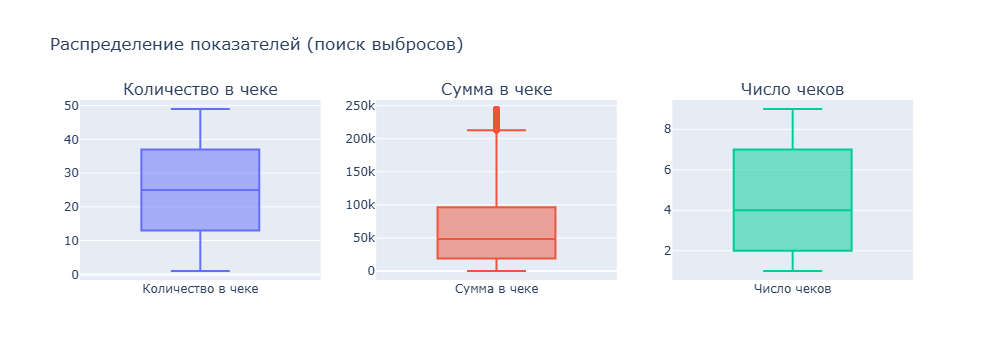

In [81]:
# Box plots для обнаружения выбросов
fig = make_subplots(rows=1, cols=3, subplot_titles=numeric_cols)

for i, col in enumerate(numeric_cols, 1):
    fig.add_trace(go.Box(y=df_long[col].dropna(), name=col), row=1, col=i)

fig.update_layout(title='Распределение показателей (поиск выбросов)', showlegend=False)
fig.show()

In [82]:
# Проверка отрицательных значений
for col in numeric_cols:
    negative_count = (df_long[col] < 0).sum()
    print(f'{col}: отрицательных значений = {negative_count}')

Количество в чеке: отрицательных значений = 0
Сумма в чеке: отрицательных значений = 0
Число чеков: отрицательных значений = 0


## 3. Анализ покупателей

In [83]:
# Преобразование типов данных
numeric_cols = ['Количество в чеке', 'Сумма в чеке', 'Число чеков']
for col in numeric_cols:
    df_long[col] = pd.to_numeric(df_long[col], errors='coerce')

# Агрегация по клиентам
client_stats = df_long.groupby('client_id').agg({
    'Сумма в чеке': 'sum',
    'Количество в чеке': 'sum',
    'Число чеков': 'sum'
}).reset_index()

client_stats.columns = ['client_id', 'Всего сумма', 'Всего количество', 'Всего чеков']
client_stats['Средний чек'] = client_stats['Всего сумма'] / client_stats['Всего чеков']

print('Статистика по клиентам:')
client_stats.describe().round(2)

Статистика по клиентам:


,Всего сумма,Всего количество,Всего чеков,Средний чек
count,1000.00,1000.00,1000.00,1000.00
mean,44865826.05,17605.57,3264.55,13748.19
std,1730843.00,528.37,99.53,490.00
min,39919822.81,16027.00,2894.00,11717.00
25%,43798600.93,17266.00,3192.00,13400.57
50%,44912160.30,17589.50,3264.50,13755.92
75%,45982940.06,17983.25,3333.00,14088.65
max,50033560.01,19330.00,3647.00,15653.81


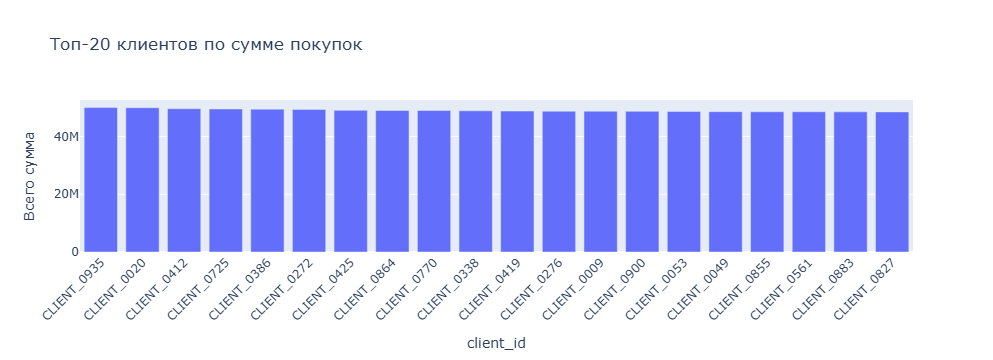

In [84]:
# Топ-20 клиентов по сумме
top_clients = client_stats.nlargest(20, 'Всего сумма')

fig = px.bar(top_clients, x='client_id', y='Всего сумма',
             title='Топ-20 клиентов по сумме покупок')
fig.update_layout(xaxis_tickangle=-45)
fig.show()

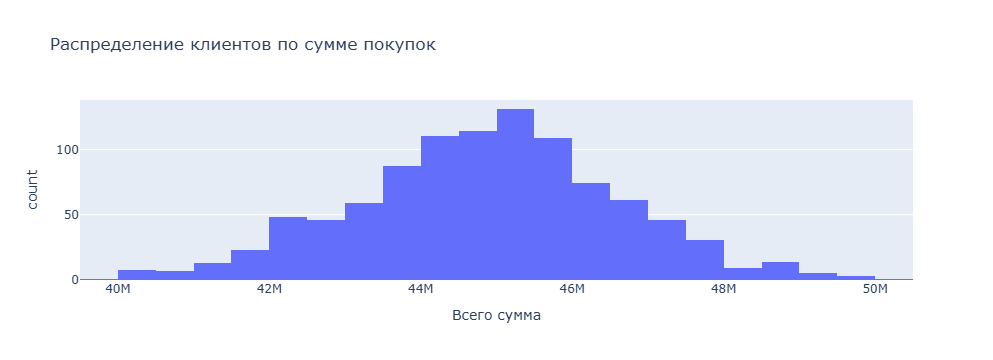

In [85]:
# Распределение клиентов по сумме покупок
fig = px.histogram(client_stats, x='Всего сумма', nbins=50,
                   title='Распределение клиентов по сумме покупок')
fig.show()

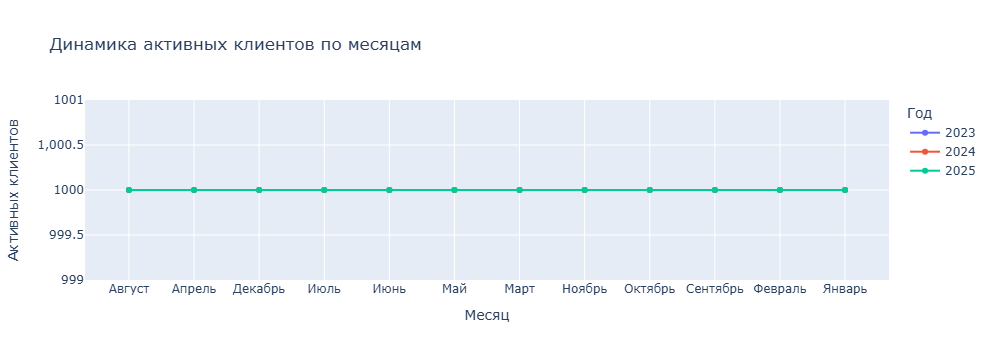

In [86]:
# Динамика активности клиентов по месяцам
monthly_clients = df_long.dropna(subset=['Сумма в чеке']).groupby(['Год', 'Месяц']).agg({
    'client_id': 'nunique',
    'Сумма в чеке': 'sum'
}).reset_index()
monthly_clients.columns = ['Год', 'Месяц', 'Активных клиентов', 'Сумма']

fig = px.line(monthly_clients, x='Месяц', y='Активных клиентов', color='Год',
              title='Динамика активных клиентов по месяцам', markers=True)
fig.show()

In [87]:
# Сегментация клиентов по сумме покупок
def segment_client(total):
    q75 = client_stats['Всего сумма'].quantile(0.75)
    q50 = client_stats['Всего сумма'].quantile(0.50)
    q25 = client_stats['Всего сумма'].quantile(0.25)
    if total >= q75:
        return 'VIP'
    elif total >= q50:
        return 'Активный'
    elif total >= q25:
        return 'Средний'
    else:
        return 'Низкий'

client_stats['Сегмент'] = client_stats['Всего сумма'].apply(segment_client)

segment_summary = client_stats.groupby('Сегмент').agg({
    'client_id': 'count',
    'Всего сумма': ['sum', 'mean']
}).round(2)
segment_summary.columns = ['Кол-во клиентов', 'Общая сумма', 'Средняя сумма']
print('Сегментация клиентов:')
segment_summary

Сегментация клиентов:


,Кол-во клиентов,Общая сумма,Средняя сумма
Сегмент,,,
VIP,250,1.175737e+10,47029461.16
Активный,250,1.135722e+10,45428898.80
Низкий,250,1.065918e+10,42636715.33
Средний,250,1.109206e+10,44368228.92


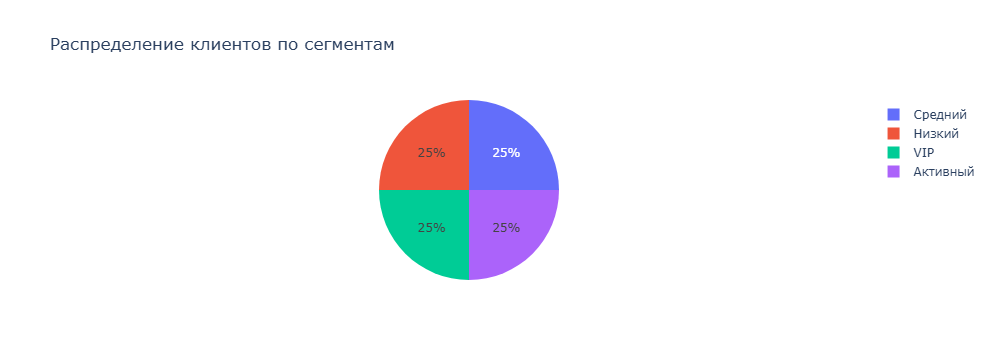

In [88]:
# Визуализация сегментов
fig = px.pie(client_stats, names='Сегмент', title='Распределение клиентов по сегментам')
fig.show()

In [89]:
# Анализ оттока: кто перестал покупать
# Клиенты, активные в 2023, но не в 2025
clients_2023 = set(df_long[(df_long['Год'] == 2023) & (df_long['Сумма в чеке'].notna())]['client_id'])
clients_2025 = set(df_long[(df_long['Год'] == 2025) & (df_long['Сумма в чеке'].notna())]['client_id'])

churned = clients_2023 - clients_2025
new_clients = clients_2025 - clients_2023

print(f'Клиентов в 2023: {len(clients_2023)}')
print(f'Клиентов в 2025: {len(clients_2025)}')
print(f'Ушедших клиентов: {len(churned)}')
print(f'Новых клиентов: {len(new_clients)}')

Клиентов в 2023: 1000
Клиентов в 2025: 1000
Ушедших клиентов: 0
Новых клиентов: 0


## 3.1 Углублённый анализ покупателей

### Средняя цена товара и сегментация по ценовым предпочтениям

Статистика по средней цене товара:
count    704911.00
mean       2549.89
std        1414.83
min         100.00
25%        1326.66
50%        2551.34
75%        3774.24
max        5000.00
Name: Средняя цена товара, dtype: float64


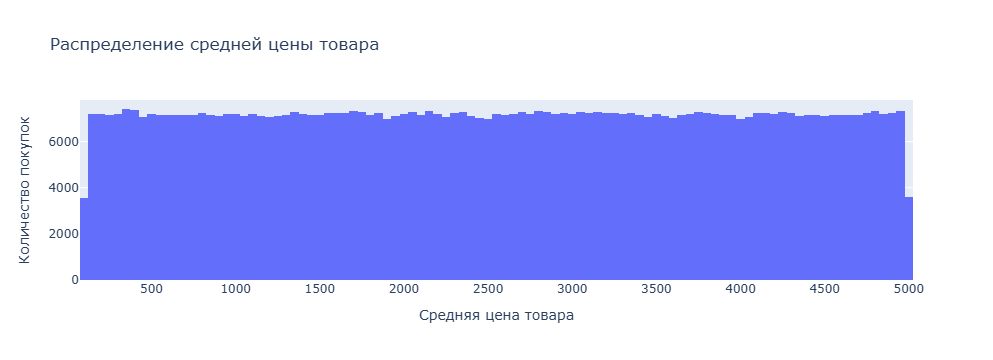

In [90]:
# Вычисляем среднюю цену товара для каждой покупки
df_long['Средняя цена товара'] = df_long['Сумма в чеке'] / df_long['Количество в чеке']

# Статистика по ценам
print('Статистика по средней цене товара:')
print(df_long['Средняя цена товара'].describe().round(2))

# Распределение средней цены товара
fig = px.histogram(df_long, x='Средняя цена товара', nbins=100,
                   title='Распределение средней цены товара')
fig.update_layout(xaxis_title='Средняя цена товара', yaxis_title='Количество покупок')
fig.show()

In [91]:
# Сегментация клиентов по средней цене покупаемого товара
client_price_stats = df_long.groupby('client_id').agg({
    'Средняя цена товара': 'mean',
    'Сумма в чеке': 'sum',
    'Число чеков': 'sum',
    'Количество в чеке': 'sum'
}).reset_index()

client_price_stats.columns = ['client_id', 'Средняя цена', 'Всего сумма', 'Всего чеков', 'Всего товаров']
client_price_stats['Частота покупок'] = client_price_stats['Всего чеков']

# Сегментация по цене товара (квартили)
q75_price = client_price_stats['Средняя цена'].quantile(0.75)
q50_price = client_price_stats['Средняя цена'].quantile(0.50)
q25_price = client_price_stats['Средняя цена'].quantile(0.25)

def price_segment(price):
    if price >= q75_price:
        return 'Премиум (дорогой товар)'
    elif price >= q50_price:
        return 'Средний+'
    elif price >= q25_price:
        return 'Средний'
    else:
        return 'Эконом (дешёвый товар)'

client_price_stats['Ценовой сегмент'] = client_price_stats['Средняя цена'].apply(price_segment)

# Статистика по ценовым сегментам
price_segment_stats = client_price_stats.groupby('Ценовой сегмент').agg({
    'client_id': 'count',
    'Средняя цена': 'mean',
    'Всего сумма': ['sum', 'mean'],
    'Всего чеков': 'mean'
}).round(2)
price_segment_stats.columns = ['Клиентов', 'Ср. цена товара', 'Общая выручка', 'Ср. выручка на клиента', 'Ср. частота покупок']

print('Сегментация клиентов по ценовым предпочтениям:')
price_segment_stats

Сегментация клиентов по ценовым предпочтениям:


,Клиентов,Ср. цена товара,Общая выручка,Ср. выручка на клиента,Ср. частота покупок
Ценовой сегмент,,,,,
Премиум (дорогой товар),250,2618.99,1.150671e+10,46026847.61,3261.33
Средний,250,2532.62,1.113561e+10,44542425.81,3265.20
Средний+,250,2568.19,1.132832e+10,45313273.71,3272.79
Эконом (дешёвый товар),250,2479.76,1.089519e+10,43580757.07,3258.90


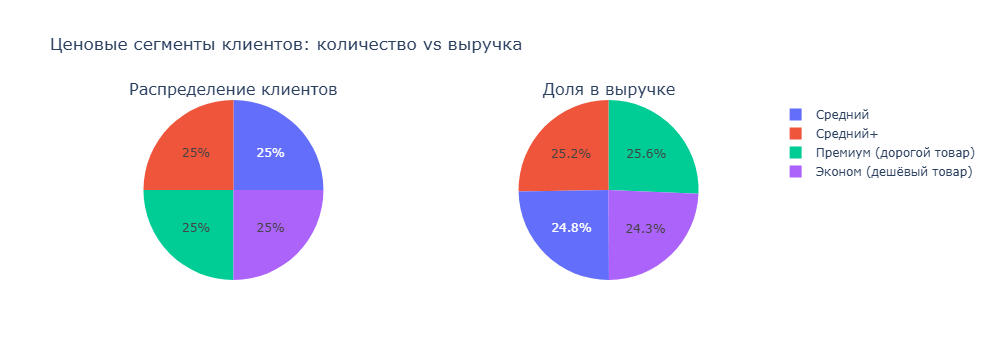

In [92]:
# Визуализация ценовых сегментов
fig = make_subplots(rows=1, cols=2, 
                    subplot_titles=['Распределение клиентов', 'Доля в выручке'],
                    specs=[[{"type": "pie"}, {"type": "pie"}]])

# Количество клиентов по сегментам
segment_counts = client_price_stats['Ценовой сегмент'].value_counts()
fig.add_trace(go.Pie(labels=segment_counts.index, values=segment_counts.values, name='Клиенты'), row=1, col=1)

# Выручка по сегментам
segment_revenue = client_price_stats.groupby('Ценовой сегмент')['Всего сумма'].sum()
fig.add_trace(go.Pie(labels=segment_revenue.index, values=segment_revenue.values, name='Выручка'), row=1, col=2)

fig.update_layout(title='Ценовые сегменты клиентов: количество vs выручка')
fig.show()

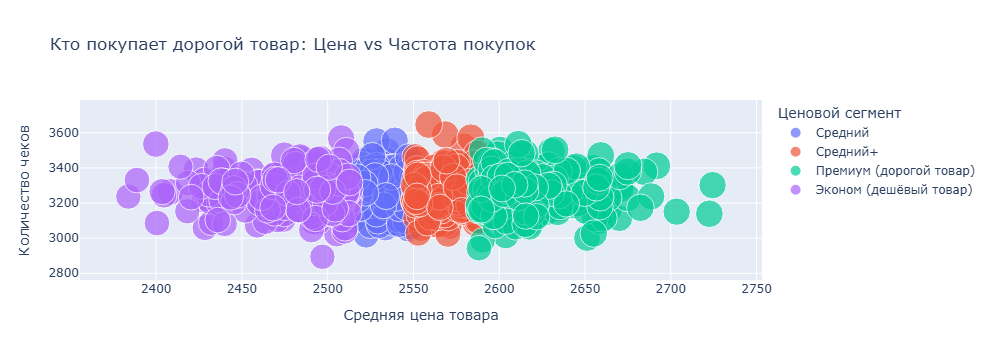

In [93]:
# Scatter: Средняя цена vs Частота покупок
fig = px.scatter(client_price_stats, x='Средняя цена', y='Частота покупок', 
                 color='Ценовой сегмент', size='Всего сумма',
                 hover_data=['client_id', 'Всего сумма'],
                 title='Кто покупает дорогой товар: Цена vs Частота покупок')
fig.update_layout(xaxis_title='Средняя цена товара', yaxis_title='Количество чеков')
fig.show()

### Динамика ценовых сегментов по годам

In [94]:
# Сегментация клиентов по годам (как менялись предпочтения)
yearly_client_stats = df_long.groupby(['Год', 'client_id']).agg({
    'Средняя цена товара': 'mean',
    'Сумма в чеке': 'sum',
    'Число чеков': 'sum'
}).reset_index()

yearly_client_stats.columns = ['Год', 'client_id', 'Средняя цена', 'Сумма', 'Чеков']

# Определяем ценовой сегмент для каждого года
yearly_client_stats['Ценовой сегмент'] = yearly_client_stats['Средняя цена'].apply(price_segment)

# Количество клиентов по сегментам и годам
segment_dynamics = yearly_client_stats.groupby(['Год', 'Ценовой сегмент']).agg({
    'client_id': 'nunique',
    'Сумма': 'sum'
}).reset_index()
segment_dynamics.columns = ['Год', 'Ценовой сегмент', 'Клиентов', 'Выручка']

print('Динамика ценовых сегментов по годам:')
segment_dynamics.pivot(index='Ценовой сегмент', columns='Год', values='Клиентов')

Динамика ценовых сегментов по годам:


Год,2023,2024,2025
Ценовой сегмент,,,
Премиум (дорогой товар),342,346,373
Средний,176,145,142
Средний+,138,144,152
Эконом (дешёвый товар),344,365,333


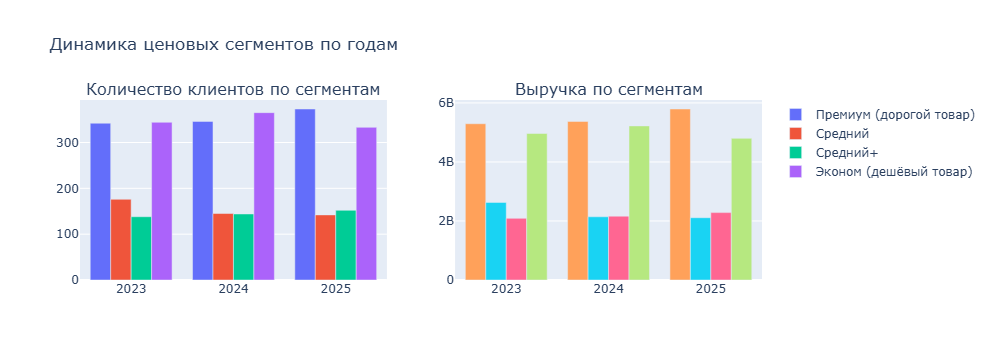

In [95]:
# Визуализация динамики сегментов
fig = make_subplots(rows=1, cols=2, 
                    subplot_titles=['Количество клиентов по сегментам', 'Выручка по сегментам'])

for i, metric in enumerate(['Клиентов', 'Выручка'], 1):
    for segment in segment_dynamics['Ценовой сегмент'].unique():
        data = segment_dynamics[segment_dynamics['Ценовой сегмент'] == segment]
        fig.add_trace(go.Bar(x=data['Год'], y=data[metric], name=segment, 
                            showlegend=(i==1)), row=1, col=i)

fig.update_layout(title='Динамика ценовых сегментов по годам', barmode='group')
fig.show()

### Анализ оттока и притока клиентов по сегментам

In [96]:
# Определяем сегмент каждого клиента в каждом году
def get_yearly_segments(year_data, year):
    segments = year_data[year_data['Год'] == year][['client_id', 'Ценовой сегмент']]
    return dict(zip(segments['client_id'], segments['Ценовой сегмент']))

segments_2023 = get_yearly_segments(yearly_client_stats, 2023)
segments_2024 = get_yearly_segments(yearly_client_stats, 2024)
segments_2025 = get_yearly_segments(yearly_client_stats, 2025)

clients_2023 = set(segments_2023.keys())
clients_2024 = set(segments_2024.keys())
clients_2025 = set(segments_2025.keys())

# Анализ оттока и притока
churned_2024 = clients_2023 - clients_2024  # Ушли в 2024
new_2024 = clients_2024 - clients_2023       # Пришли в 2024
churned_2025 = clients_2024 - clients_2025  # Ушли в 2025
new_2025 = clients_2025 - clients_2024       # Пришли в 2025

print('=== Отток и приток клиентов ===')
print(f'\n2023 → 2024:')
print(f'  Ушло клиентов: {len(churned_2024)}')
print(f'  Пришло новых: {len(new_2024)}')
print(f'\n2024 → 2025:')
print(f'  Ушло клиентов: {len(churned_2025)}')
print(f'  Пришло новых: {len(new_2025)}')

=== Отток и приток клиентов ===

2023 → 2024:
  Ушло клиентов: 0
  Пришло новых: 0

2024 → 2025:
  Ушло клиентов: 0
  Пришло новых: 0


In [97]:
# Анализ оттока по сегментам - кто именно ушёл?
def analyze_churn_by_segment(churned_clients, segment_dict):
    """Анализ ушедших клиентов по их последнему сегменту"""
    churn_by_segment = {}
    for client in churned_clients:
        if client in segment_dict:
            segment = segment_dict[client]
            churn_by_segment[segment] = churn_by_segment.get(segment, 0) + 1
    return churn_by_segment

churn_2024_by_segment = analyze_churn_by_segment(churned_2024, segments_2023)
churn_2025_by_segment = analyze_churn_by_segment(churned_2025, segments_2024)

# Анализ новых клиентов по сегментам
def analyze_new_by_segment(new_clients, segment_dict):
    """Анализ новых клиентов по их сегменту"""
    new_by_segment = {}
    for client in new_clients:
        if client in segment_dict:
            segment = segment_dict[client]
            new_by_segment[segment] = new_by_segment.get(segment, 0) + 1
    return new_by_segment

new_2024_by_segment = analyze_new_by_segment(new_2024, segments_2024)
new_2025_by_segment = analyze_new_by_segment(new_2025, segments_2025)

# Создаём DataFrame для визуализации
churn_data = []
for segment in ['Премиум (дорогой товар)', 'Средний+', 'Средний', 'Эконом (дешёвый товар)']:
    churn_data.append({
        'Сегмент': segment,
        'Ушло 2023→2024': churn_2024_by_segment.get(segment, 0),
        'Пришло 2024': new_2024_by_segment.get(segment, 0),
        'Ушло 2024→2025': churn_2025_by_segment.get(segment, 0),
        'Пришло 2025': new_2025_by_segment.get(segment, 0)
    })

churn_df = pd.DataFrame(churn_data)
print('Отток и приток по ценовым сегментам:')
churn_df

Отток и приток по ценовым сегментам:


,Сегмент,Ушло 2023→2024,Пришло 2024,Ушло 2024→2025,Пришло 2025
0,Премиум (дорогой товар),0,0,0,0
1,Средний+,0,0,0,0
2,Средний,0,0,0,0
3,Эконом (дешёвый товар),0,0,0,0


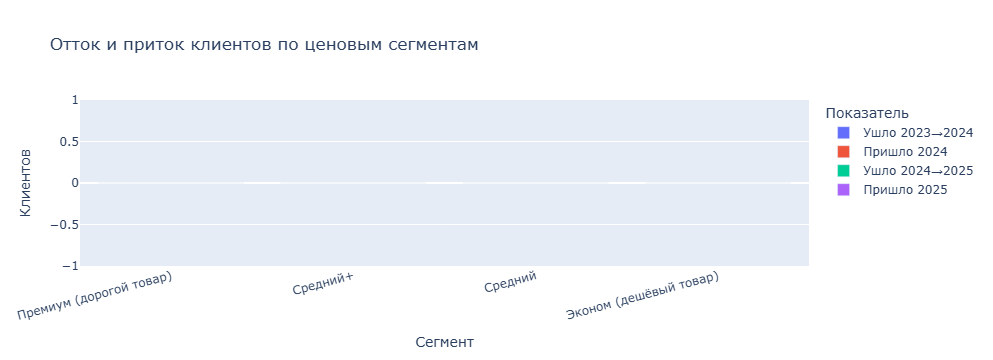

In [98]:
# Визуализация оттока и притока по сегментам
churn_melted = churn_df.melt(id_vars=['Сегмент'], var_name='Показатель', value_name='Клиентов')

fig = px.bar(churn_melted, x='Сегмент', y='Клиентов', color='Показатель',
             title='Отток и приток клиентов по ценовым сегментам', barmode='group')
fig.update_layout(xaxis_tickangle=-15)
fig.show()

### Миграция клиентов между сегментами (когортный анализ)

In [99]:
# Матрица миграции: как клиенты переходят между сегментами
def build_migration_matrix(from_segments, to_segments):
    """Строит матрицу миграции между сегментами"""
    segments = ['Премиум (дорогой товар)', 'Средний+', 'Средний', 'Эконом (дешёвый товар)']
    matrix = pd.DataFrame(0, index=segments, columns=segments)
    
    common_clients = set(from_segments.keys()) & set(to_segments.keys())
    
    for client in common_clients:
        from_seg = from_segments[client]
        to_seg = to_segments[client]
        matrix.loc[from_seg, to_seg] += 1
    
    return matrix

# Миграция 2023 → 2024
migration_2023_2024 = build_migration_matrix(segments_2023, segments_2024)
print('Миграция клиентов 2023 → 2024:')
print('(строки - сегмент в 2023, столбцы - сегмент в 2024)')
migration_2023_2024

Миграция клиентов 2023 → 2024:
(строки - сегмент в 2023, столбцы - сегмент в 2024)


,Премиум (дорогой товар),Средний+,Средний,Эконом (дешёвый товар)
Премиум (дорогой товар),113,51,51,127
Средний+,51,20,19,48
Средний,60,22,30,64
Эконом (дешёвый товар),122,51,45,126


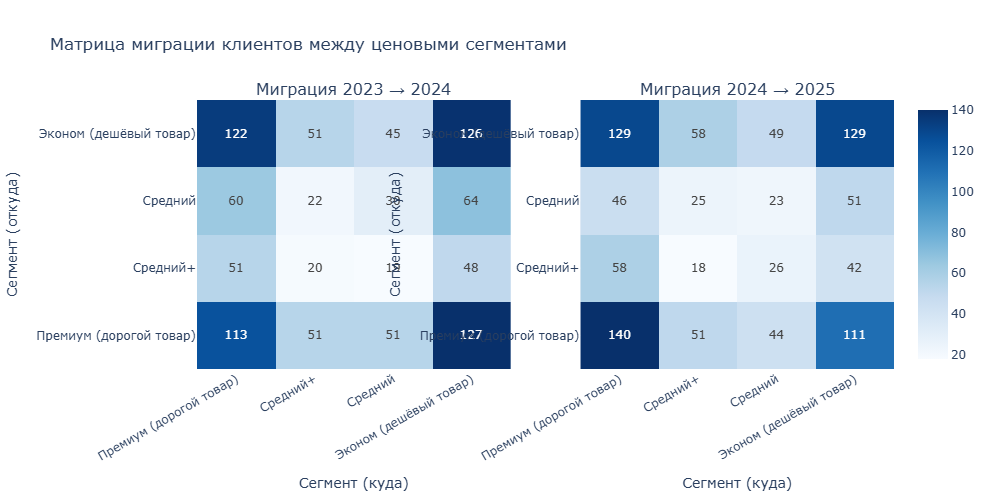

In [100]:
# Визуализация матрицы миграции как тепловая карта
fig = make_subplots(rows=1, cols=2, 
                    subplot_titles=['Миграция 2023 → 2024', 'Миграция 2024 → 2025'])

migration_2024_2025 = build_migration_matrix(segments_2024, segments_2025)

# Первая матрица
fig.add_trace(go.Heatmap(
    z=migration_2023_2024.values,
    x=migration_2023_2024.columns,
    y=migration_2023_2024.index,
    text=migration_2023_2024.values,
    texttemplate='%{text}',
    colorscale='Blues',
    showscale=False
), row=1, col=1)

# Вторая матрица
fig.add_trace(go.Heatmap(
    z=migration_2024_2025.values,
    x=migration_2024_2025.columns,
    y=migration_2024_2025.index,
    text=migration_2024_2025.values,
    texttemplate='%{text}',
    colorscale='Blues',
    showscale=True
), row=1, col=2)

fig.update_layout(title='Матрица миграции клиентов между ценовыми сегментами',
                  height=500)
fig.update_xaxes(title_text='Сегмент (куда)', tickangle=-30)
fig.update_yaxes(title_text='Сегмент (откуда)')
fig.show()

In [101]:
# Анализ миграции: удержание, апгрейд, даунгрейд
def analyze_migration(matrix, period_name):
    """Анализирует матрицу миграции"""
    total = matrix.sum().sum()
    diagonal = matrix.values.diagonal().sum()  # Остались в том же сегменте
    
    # Апгрейд (переход в более дорогой сегмент)
    upgrade = 0
    downgrade = 0
    segments = list(matrix.index)
    
    for i, from_seg in enumerate(segments):
        for j, to_seg in enumerate(segments):
            if i > j:  # Апгрейд (индекс уменьшается = более дорогой)
                upgrade += matrix.loc[from_seg, to_seg]
            elif i < j:  # Даунгрейд
                downgrade += matrix.loc[from_seg, to_seg]
    
    print(f'\n=== {period_name} ===')
    print(f'Всего клиентов в обоих периодах: {total}')
    print(f'Остались в том же сегменте: {diagonal} ({diagonal/total*100:.1f}%)')
    print(f'Апгрейд (перешли на дорогой товар): {upgrade} ({upgrade/total*100:.1f}%)')
    print(f'Даунгрейд (перешли на дешёвый товар): {downgrade} ({downgrade/total*100:.1f}%)')

analyze_migration(migration_2023_2024, '2023 → 2024')
analyze_migration(migration_2024_2025, '2024 → 2025')


=== 2023 → 2024 ===
Всего клиентов в обоих периодах: 1000
Остались в том же сегменте: 289 (28.9%)
Апгрейд (перешли на дорогой товар): 351 (35.1%)
Даунгрейд (перешли на дешёвый товар): 360 (36.0%)

=== 2024 → 2025 ===
Всего клиентов в обоих периодах: 1000
Остались в том же сегменте: 310 (31.0%)
Апгрейд (перешли на дорогой товар): 365 (36.5%)
Даунгрейд (перешли на дешёвый товар): 325 (32.5%)


### Sankey диаграммы миграции клиентов

In [ ]:
# Функция для построения Sankey диаграммы миграции
def create_sankey_migration(matrix, title):
    """Создаёт Sankey диаграмму на основе матрицы миграции"""
    segments = ['Премиум (дорогой товар)', 'Средний+', 'Средний', 'Эконом (дешёвый товар)']
    short_names = ['Премиум', 'Средний+', 'Средний', 'Эконом']
    
    # Метки для левой и правой стороны
    sankey_labels = [f'{s} (до)' for s in short_names] + [f'{s} (после)' for s in short_names]
    
    # Создаём потоки
    source = []
    target = []
    value = []
    
    for i, from_seg in enumerate(segments):
        for j, to_seg in enumerate(segments):
            if matrix.loc[from_seg, to_seg] > 0:
                source.append(i)           # Левый индекс
                target.append(j + 4)       # Правый индекс (смещение на 4)
                value.append(matrix.loc[from_seg, to_seg])
    
    # Цвета для потоков
    colors = ['rgba(255,215,0,0.5)', 'rgba(100,149,237,0.5)', 
              'rgba(144,238,144,0.5)', 'rgba(255,182,193,0.5)']
    link_colors = [colors[s % 4] for s in source]
    
    fig = go.Figure(data=[go.Sankey(
        node=dict(
            pad=15,
            thickness=20,
            line=dict(color='black', width=0.5),
            label=sankey_labels,
            color=['gold', 'cornflowerblue', 'lightgreen', 'lightpink'] * 2
        ),
        link=dict(
            source=source,
            target=target,
            value=value,
            color=link_colors
        )
    )])
    
    fig.update_layout(
        title=title,
        font_size=12,
        height=500
    )
    return fig

# Sankey 2023 → 2024
fig_sankey_2023_2024 = create_sankey_migration(migration_2023_2024, 'Миграция клиентов 2023 → 2024')
fig_sankey_2023_2024.show()

In [ ]:
# Sankey 2024 → 2025
fig_sankey_2024_2025 = create_sankey_migration(migration_2024_2025, 'Миграция клиентов 2024 → 2025')
fig_sankey_2024_2025.show()

In [ ]:
# Миграция за весь период 2023 → 2025
migration_2023_2025 = build_migration_matrix(segments_2023, segments_2025)

print('Миграция клиентов за весь период 2023 → 2025:')
print('(строки - сегмент в 2023, столбцы - сегмент в 2025)')
migration_2023_2025

In [ ]:
# Sankey 2023 → 2025 (весь период)
fig_sankey_2023_2025 = create_sankey_migration(migration_2023_2025, 'Миграция клиентов 2023 → 2025 (весь период)')
fig_sankey_2023_2025.show()

# Анализ миграции за весь период
analyze_migration(migration_2023_2025, '2023 → 2025 (весь период)')

### Профиль покупателей дорогого товара

In [102]:
# Детальный профиль покупателей дорогого товара (Премиум сегмент)
premium_clients = client_price_stats[client_price_stats['Ценовой сегмент'] == 'Премиум (дорогой товар)']
economy_clients = client_price_stats[client_price_stats['Ценовой сегмент'] == 'Эконом (дешёвый товар)']

print('=== Сравнение Премиум vs Эконом клиентов ===\n')

comparison = pd.DataFrame({
    'Показатель': ['Количество клиентов', 'Средняя цена товара', 'Средняя выручка на клиента', 
                   'Среднее кол-во чеков', 'Среднее кол-во товаров'],
    'Премиум': [
        len(premium_clients),
        premium_clients['Средняя цена'].mean().round(2),
        premium_clients['Всего сумма'].mean().round(2),
        premium_clients['Всего чеков'].mean().round(2),
        premium_clients['Всего товаров'].mean().round(2)
    ],
    'Эконом': [
        len(economy_clients),
        economy_clients['Средняя цена'].mean().round(2),
        economy_clients['Всего сумма'].mean().round(2),
        economy_clients['Всего чеков'].mean().round(2),
        economy_clients['Всего товаров'].mean().round(2)
    ]
})
comparison['Разница'] = comparison['Премиум'] / comparison['Эконом']
comparison['Разница'] = comparison['Разница'].apply(lambda x: f'{x:.1f}x' if x > 0 else '-')
comparison

=== Сравнение Премиум vs Эконом клиентов ===



,Показатель,Премиум,Эконом,Разница
0,Количество клиентов,250.00,250.00,1.0x
1,Средняя цена товара,2618.99,2479.76,1.1x
2,Средняя выручка на клиента,46026847.61,43580757.07,1.1x
3,Среднее кол-во чеков,3261.33,3258.90,1.0x
4,Среднее кол-во товаров,17582.59,17575.44,1.0x


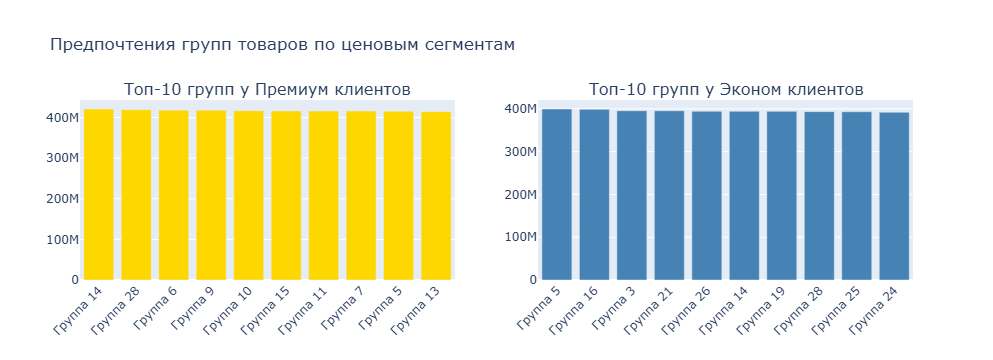

In [103]:
# Какие группы товаров предпочитают Премиум клиенты?
df_with_price_segment = df_long.merge(client_price_stats[['client_id', 'Ценовой сегмент']], on='client_id')

# Топ-10 групп товаров для Премиум клиентов
premium_groups = df_with_price_segment[df_with_price_segment['Ценовой сегмент'] == 'Премиум (дорогой товар)']
premium_top_groups = premium_groups.groupby('Группа')['Сумма в чеке'].sum().nlargest(10).reset_index()
premium_top_groups.columns = ['Группа', 'Выручка']

# Топ-10 групп товаров для Эконом клиентов
economy_groups = df_with_price_segment[df_with_price_segment['Ценовой сегмент'] == 'Эконом (дешёвый товар)']
economy_top_groups = economy_groups.groupby('Группа')['Сумма в чеке'].sum().nlargest(10).reset_index()
economy_top_groups.columns = ['Группа', 'Выручка']

fig = make_subplots(rows=1, cols=2, 
                    subplot_titles=['Топ-10 групп у Премиум клиентов', 'Топ-10 групп у Эконом клиентов'])

fig.add_trace(go.Bar(x=premium_top_groups['Группа'], y=premium_top_groups['Выручка'], 
                     marker_color='gold', name='Премиум'), row=1, col=1)
fig.add_trace(go.Bar(x=economy_top_groups['Группа'], y=economy_top_groups['Выручка'], 
                     marker_color='steelblue', name='Эконом'), row=1, col=2)

fig.update_layout(title='Предпочтения групп товаров по ценовым сегментам', showlegend=False)
fig.update_xaxes(tickangle=-45)
fig.show()

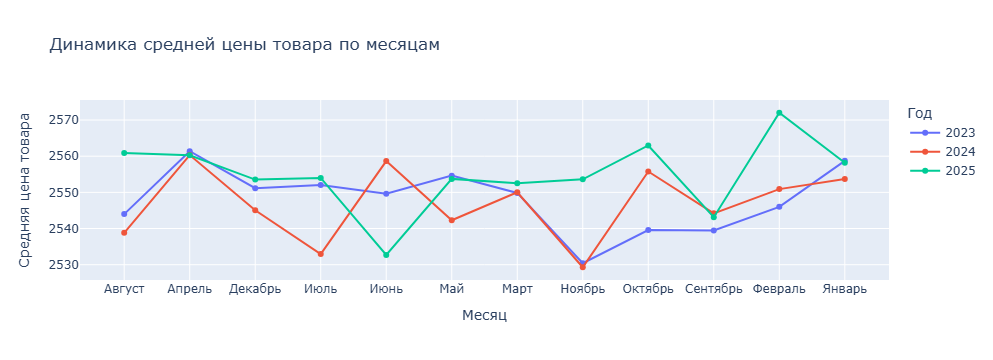

In [104]:
# Динамика средней цены товара по месяцам и годам
monthly_price = df_long.groupby(['Год', 'Месяц']).agg({
    'Средняя цена товара': 'mean'
}).reset_index()

fig = px.line(monthly_price, x='Месяц', y='Средняя цена товара', color='Год',
              title='Динамика средней цены товара по месяцам', markers=True)
fig.update_layout(yaxis_title='Средняя цена товара')
fig.show()

### Итоговая сводка по анализу покупателей

In [105]:
# Итоговая сводка
print('='*60)
print('ИТОГОВАЯ СВОДКА ПО АНАЛИЗУ ПОКУПАТЕЛЕЙ')
print('='*60)

print(f'\n📊 ОБЩАЯ СТАТИСТИКА:')
print(f'   Всего клиентов: {len(client_price_stats)}')
print(f'   Период анализа: 2023-2025')

print(f'\n💰 ЦЕНОВЫЕ СЕГМЕНТЫ:')
for segment in ['Премиум (дорогой товар)', 'Средний+', 'Средний', 'Эконом (дешёвый товар)']:
    count = len(client_price_stats[client_price_stats['Ценовой сегмент'] == segment])
    pct = count / len(client_price_stats) * 100
    print(f'   {segment}: {count} клиентов ({pct:.1f}%)')

print(f'\n📈 ДИНАМИКА КЛИЕНТСКОЙ БАЗЫ:')
print(f'   2023 → 2024: ушло {len(churned_2024)}, пришло {len(new_2024)}')
print(f'   2024 → 2025: ушло {len(churned_2025)}, пришло {len(new_2025)}')

print(f'\n🔄 МИГРАЦИЯ МЕЖДУ СЕГМЕНТАМИ (2024→2025):')
total = migration_2024_2025.sum().sum()
diagonal = migration_2024_2025.values.diagonal().sum()
print(f'   Остались в своём сегменте: {diagonal/total*100:.1f}%')

print(f'\n💎 ПРЕМИУМ КЛИЕНТЫ:')
print(f'   Средняя цена товара: {premium_clients["Средняя цена"].mean():.2f}')
print(f'   Средняя выручка на клиента: {premium_clients["Всего сумма"].mean():.2f}')
print(f'   Доля в общей выручке: {premium_clients["Всего сумма"].sum() / client_price_stats["Всего сумма"].sum() * 100:.1f}%')

ИТОГОВАЯ СВОДКА ПО АНАЛИЗУ ПОКУПАТЕЛЕЙ

📊 ОБЩАЯ СТАТИСТИКА:
   Всего клиентов: 1000
   Период анализа: 2023-2025

💰 ЦЕНОВЫЕ СЕГМЕНТЫ:
   Премиум (дорогой товар): 250 клиентов (25.0%)
   Средний+: 250 клиентов (25.0%)
   Средний: 250 клиентов (25.0%)
   Эконом (дешёвый товар): 250 клиентов (25.0%)

📈 ДИНАМИКА КЛИЕНТСКОЙ БАЗЫ:
   2023 → 2024: ушло 0, пришло 0
   2024 → 2025: ушло 0, пришло 0

🔄 МИГРАЦИЯ МЕЖДУ СЕГМЕНТАМИ (2024→2025):
   Остались в своём сегменте: 31.0%

💎 ПРЕМИУМ КЛИЕНТЫ:
   Средняя цена товара: 2618.99
   Средняя выручка на клиента: 46026847.61
   Доля в общей выручке: 25.6%


## 4. Анализ групп товаров

In [106]:
# Агрегация по группам товаров
group_stats = df_long.groupby('Группа').agg({
    'Сумма в чеке': 'sum',
    'Количество в чеке': 'sum',
    'Число чеков': 'sum'
}).reset_index()

group_stats = group_stats.sort_values('Сумма в чеке', ascending=False)
print('Топ группы товаров по сумме:')
group_stats.head(10)

Топ группы товаров по сумме:


,Группа,Сумма в чеке,Количество в чеке,Число чеков
7,Группа 16,1.618473e+09,632349,117156
23,Группа 5,1.617175e+09,633135,117203
27,Группа 9,1.615819e+09,633638,118231
4,Группа 13,1.614887e+09,630626,116423
6,Группа 15,1.614368e+09,630933,116847
20,Группа 28,1.614274e+09,630703,117182
5,Группа 14,1.613068e+09,630466,116113
21,Группа 3,1.612498e+09,631742,116604
13,Группа 21,1.612371e+09,630522,116470
24,Группа 6,1.608846e+09,628579,116090


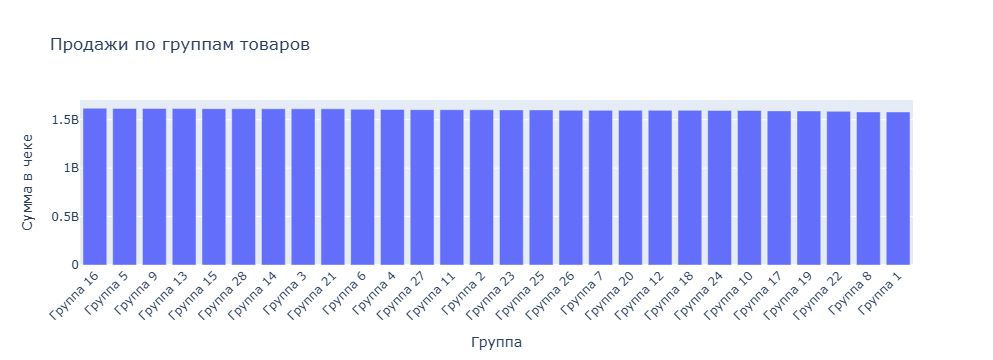

In [107]:
# Визуализация продаж по группам
fig = px.bar(group_stats, x='Группа', y='Сумма в чеке',
             title='Продажи по группам товаров')
fig.update_layout(xaxis_tickangle=-45)
fig.show()

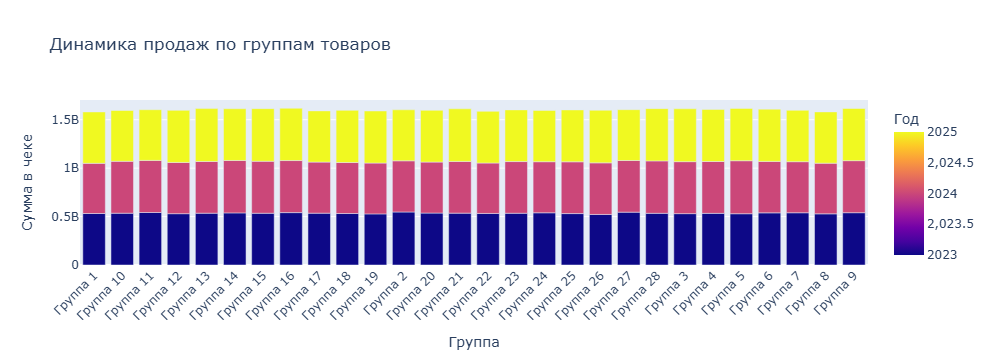

In [108]:
# Динамика продаж по группам по годам
group_year = df_long.groupby(['Год', 'Группа'])['Сумма в чеке'].sum().reset_index()

fig = px.bar(group_year, x='Группа', y='Сумма в чеке', color='Год',
             title='Динамика продаж по группам товаров', barmode='group')
fig.update_layout(xaxis_tickangle=-45)
fig.show()

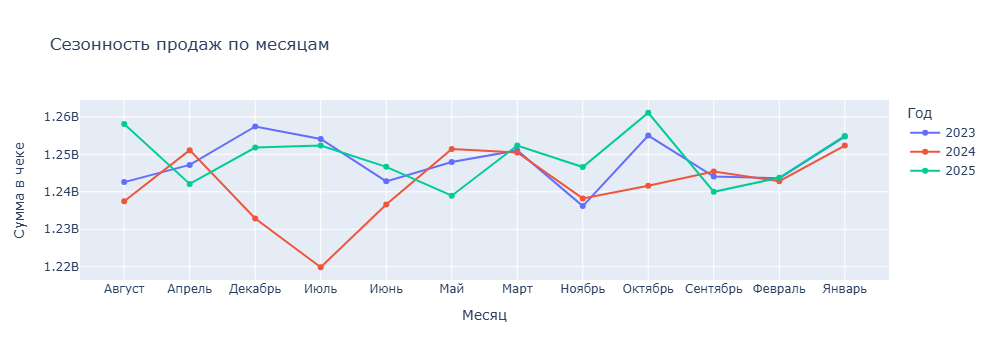

In [109]:
# Сезонность продаж по месяцам
monthly_sales = df_long.groupby(['Год', 'Месяц'])['Сумма в чеке'].sum().reset_index()

fig = px.line(monthly_sales, x='Месяц', y='Сумма в чеке', color='Год',
              title='Сезонность продаж по месяцам', markers=True)
fig.show()

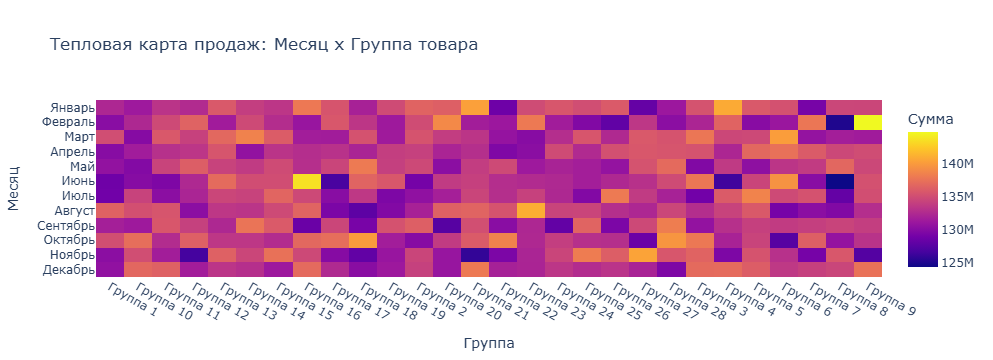

In [110]:
# Тепловая карта: месяц x группа товара
heatmap_data = df_long.groupby(['Месяц', 'Группа'])['Сумма в чеке'].sum().reset_index()
heatmap_pivot = heatmap_data.pivot(index='Месяц', columns='Группа', values='Сумма в чеке')

# Упорядочиваем месяцы
months_order = ['Январь', 'Февраль', 'Март', 'Апрель', 'Май', 'Июнь',
               'Июль', 'Август', 'Сентябрь', 'Октябрь', 'Ноябрь', 'Декабрь']
heatmap_pivot = heatmap_pivot.reindex(months_order)

fig = px.imshow(heatmap_pivot, aspect='auto',
                title='Тепловая карта продаж: Месяц x Группа товара',
                labels=dict(color='Сумма'))
fig.show()

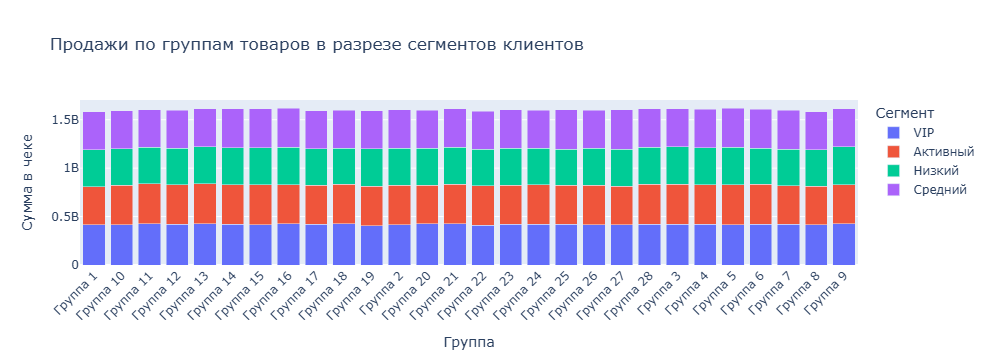

In [111]:
# Популярность групп у разных сегментов клиентов
df_with_segment = df_long.merge(client_stats[['client_id', 'Сегмент']], on='client_id')

segment_group = df_with_segment.groupby(['Сегмент', 'Группа'])['Сумма в чеке'].sum().reset_index()

fig = px.bar(segment_group, x='Группа', y='Сумма в чеке', color='Сегмент',
             title='Продажи по группам товаров в разрезе сегментов клиентов', barmode='stack')
fig.update_layout(xaxis_tickangle=-45)
fig.show()

## 5. Экспорт в standalone HTML

In [112]:
# Создание единого HTML отчёта
from plotly.subplots import make_subplots
import plotly.io as pio

# Собираем все графики
figures = []

# 1. Пропуски по месяцам
fig1 = px.bar(missing_by_month, x='Месяц', y='Пропуски %', color='Год',
              title='Процент пропусков по месяцам', barmode='group')
figures.append(fig1)

# 2. Box plots
fig2 = make_subplots(rows=1, cols=3, subplot_titles=numeric_cols)
for i, col in enumerate(numeric_cols, 1):
    fig2.add_trace(go.Box(y=df_long[col].dropna(), name=col), row=1, col=i)
fig2.update_layout(title='Распределение показателей', showlegend=False)
figures.append(fig2)

# 3. Топ-20 клиентов
fig3 = px.bar(top_clients, x='client_id', y='Всего сумма',
              title='Топ-20 клиентов по сумме покупок')
fig3.update_layout(xaxis_tickangle=-45)
figures.append(fig3)

# 4. Распределение клиентов
fig4 = px.histogram(client_stats, x='Всего сумма', nbins=50,
                    title='Распределение клиентов по сумме покупок')
figures.append(fig4)

# 5. Динамика активных клиентов
fig5 = px.line(monthly_clients, x='Месяц', y='Активных клиентов', color='Год',
               title='Динамика активных клиентов', markers=True)
figures.append(fig5)

# 6. Сегменты клиентов
fig6 = px.pie(client_stats, names='Сегмент', title='Распределение клиентов по сегментам')
figures.append(fig6)

# 7. Продажи по группам
fig7 = px.bar(group_stats, x='Группа', y='Сумма в чеке',
              title='Продажи по группам товаров')
fig7.update_layout(xaxis_tickangle=-45)
figures.append(fig7)

# 8. Динамика по годам
fig8 = px.bar(group_year, x='Группа', y='Сумма в чеке', color='Год',
              title='Динамика продаж по группам', barmode='group')
fig8.update_layout(xaxis_tickangle=-45)
figures.append(fig8)

# 9. Сезонность
fig9 = px.line(monthly_sales, x='Месяц', y='Сумма в чеке', color='Год',
               title='Сезонность продаж', markers=True)
figures.append(fig9)

# 10. Тепловая карта
fig10 = px.imshow(heatmap_pivot, aspect='auto',
                  title='Тепловая карта: Месяц x Группа',
                  labels=dict(color='Сумма'))
figures.append(fig10)

# 11. Сегменты x группы
fig11 = px.bar(segment_group, x='Группа', y='Сумма в чеке', color='Сегмент',
               title='Продажи по сегментам и группам', barmode='stack')
fig11.update_layout(xaxis_tickangle=-45)
figures.append(fig11)

print(f'Собрано {len(figures)} графиков')

Собрано 11 графиков


In [113]:
# Создание HTML файла
html_content = '''
<!DOCTYPE html>
<html>
<head>
    <meta charset="utf-8">
    <title>Исследование продаж</title>
    <style>
        body { font-family: Arial, sans-serif; margin: 20px; }
        h1 { color: #333; }
        h2 { color: #666; border-bottom: 1px solid #ddd; padding-bottom: 10px; }
        .chart { margin-bottom: 40px; }
        .summary { background: #f5f5f5; padding: 15px; border-radius: 5px; margin-bottom: 20px; }
    </style>
</head>
<body>
    <h1>Исследование продаж</h1>
    
    <div class="summary">
        <h3>Общая информация</h3>
        <ul>
            <li>Количество клиентов: ''' + str(len(client_stats)) + '''</li>
            <li>Период: 2023-2025</li>
            <li>Групп товаров: 28</li>
        </ul>
    </div>
    
    <h2>1. Качество данных</h2>
'''

# Добавляем графики
sections = [
    (0, 2, 'Качество данных'),
    (2, 6, 'Анализ покупателей'),
    (6, 11, 'Анализ групп товаров')
]

section_idx = 0
for i, fig in enumerate(figures):
    if section_idx < len(sections) - 1 and i == sections[section_idx + 1][0]:
        section_idx += 1
        html_content += f'<h2>{section_idx + 1}. {sections[section_idx][2]}</h2>\n'
    
    html_content += f'<div class="chart">{pio.to_html(fig, full_html=False, include_plotlyjs="cdn" if i == 0 else False)}</div>\n'

html_content += '''
</body>
</html>
'''

# Сохраняем HTML
output_file = 'sales_report.html'
with open(output_file, 'w', encoding='utf-8') as f:
    f.write(html_content)

print(f'Отчёт сохранён: {output_file}')

Отчёт сохранён: sales_report.html
